In [36]:
import numpy as np
import cv2
import time
from PIL import Image, ImageFilter
import matplotlib.pyplot as plt
from scipy.ndimage import gaussian_filter

In [2]:
img = Image.open("C://Users//Trust_pc_dz//Documents//ISAT//TP2ISAT//Satellite_Imagery_Analysis//TPISAT-3//imag sat//NaturalColorImages.jpg")
img2 = Image.open("C://Users//Trust_pc_dz//Documents//ISAT//TP2ISAT//Satellite_Imagery_Analysis//TPISAT-3//imag sat//FalseColorImages.jpg")
images = [img, img2]

In [3]:
def display_images_in_grid(images, titles='',N=2, M=2,display=False,gray=False):

    fig, axs = plt.subplots(N, M, figsize=(15, 15))  
    
    for i, ax in enumerate(axs.flat):  
        if i < len(images): 
            if gray == True :
                ax.imshow(images[i], cmap='gray') 
            else :
                ax.imshow(images[i]) 
            if display == True: 
                ax.set_title(titles[i])  
            ax.axis('off')  
        else:
            ax.axis('off')  

    plt.tight_layout()
    plt.show()
    
def Split_RGB(img):

    img = np.array(img)
    R = img[:, :, 0]  
    G = img[:, :, 1]  
    B = img[:, :, 2]  

    return R, G, B

def Split_RGB_precessing(img):
    RGB_split_images = Split_RGB(img)
    display_images_in_grid(RGB_split_images,['R','G','B'],1,3,True,True)
    return RGB_split_images 


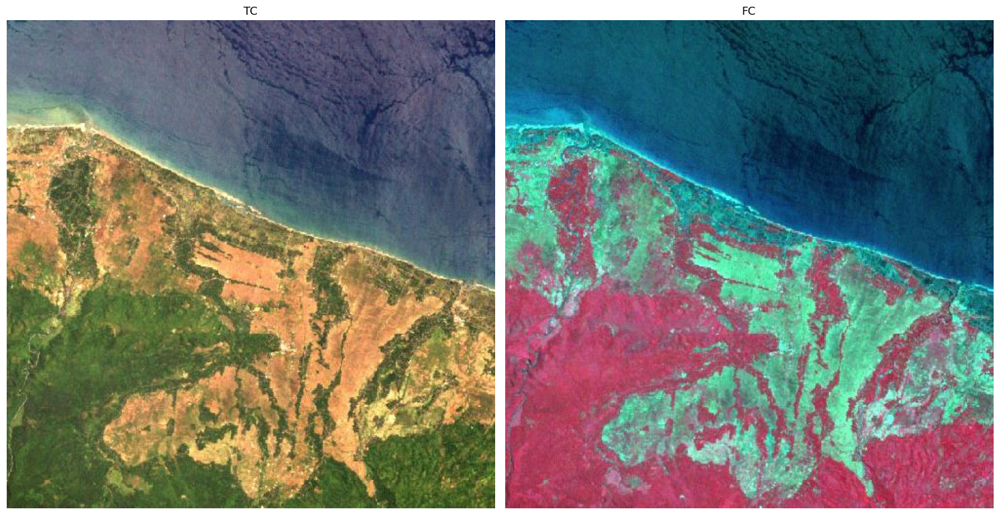

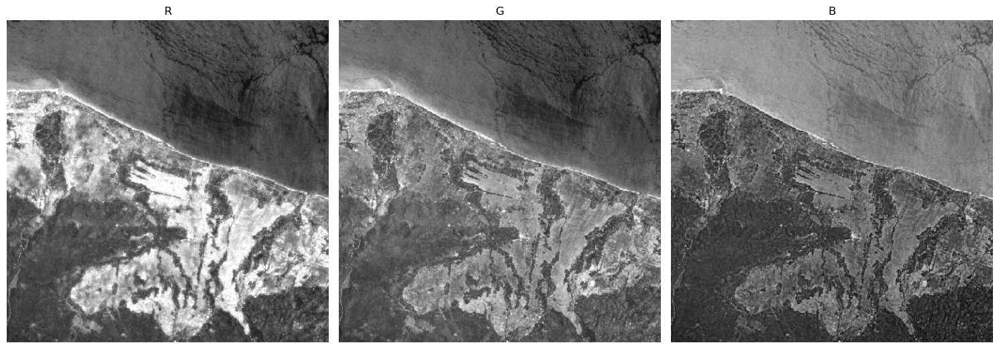

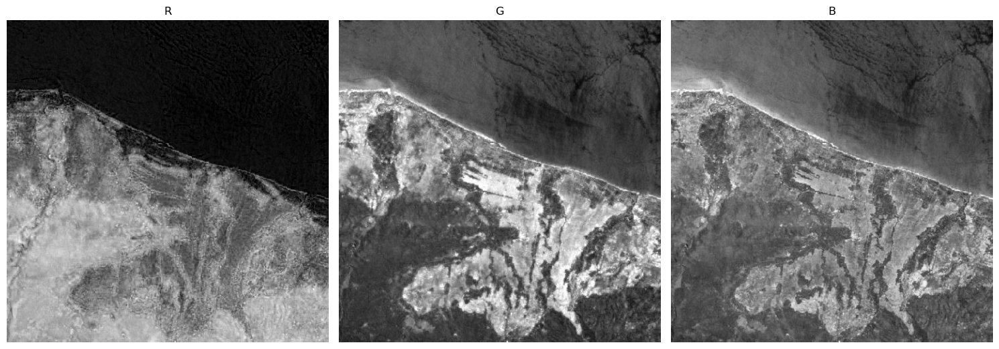

(array([[ 23,  18,  24, ...,  23,  14,   3],
        [  2,   0,   4, ...,  19,  10,   0],
        [  0,   0,   8, ...,  20,   9,   0],
        ...,
        [136, 133, 144, ..., 182, 178, 171],
        [143, 144, 151, ..., 180, 174, 168],
        [147, 151, 158, ..., 180, 171, 163]], dtype=uint8),
 array([[69, 64, 72, ..., 62, 53, 42],
        [52, 48, 54, ..., 61, 49, 36],
        [44, 51, 62, ..., 62, 51, 38],
        ...,
        [55, 48, 50, ..., 82, 79, 75],
        [62, 56, 57, ..., 75, 69, 63],
        [64, 63, 63, ..., 69, 60, 52]], dtype=uint8),
 array([[119, 114, 121, ...,  77,  68,  57],
        [101,  97, 103, ...,  75,  64,  51],
        [ 91,  98, 109, ...,  78,  67,  54],
        ...,
        [ 74,  69,  74, ..., 110, 107, 102],
        [ 81,  78,  81, ..., 105,  99,  93],
        [ 84,  85,  87, ..., 101,  92,  84]], dtype=uint8))

In [4]:
display_images_in_grid(images,['TC','FC'],1,2,True,True)
Split_RGB_precessing(img)
Split_RGB_precessing(img2)

## Etape 1 : Rehaussement de contours

In [5]:
def convolve(image, kernel):
    fh, fw = kernel.shape
    ih, iw = image.shape
    filtered_image = np.zeros_like(image)
    padded_image = np.pad(image, ((fh // 2, fh // 2), (fw // 2, fw // 2)), mode='reflect')

    for y in range(ih):
        for x in range(iw):
            window = padded_image[y:y + fh, x:x + fw]
            result = np.sum(window * kernel)
            filtered_image[y, x] = result

    return filtered_image

In [6]:
def sobel(image, threshold):
    image_array = np.array(image, dtype=np.float64)

    sobel_x = np.array([[-1, 0, 1],
                        [-2, 0, 2],
                        [-1, 0, 1]])

    sobel_y = np.array([[-1, -2, -1],
                        [ 0,  0,  0],
                        [ 1,  2,  1]])

    edges_x = convolve(image_array, sobel_x)
    edges_y = convolve(image_array, sobel_y)

    # Calculer la magnitude des gradients
    amplitude = np.sqrt(edges_x**2 + edges_y**2)
    
    direction = np.arctan2(edges_y, edges_x)

    # Convertir la magnitude des gradients en image
    edges_image = Image.fromarray(np.clip(amplitude, 0, 255).astype(np.uint8))
    
    binary_edges = (amplitude > threshold).astype(np.uint8) * 255
    
    binary_edges_image = Image.fromarray(binary_edges)

    edge_positions = np.argwhere(binary_edges)

    return binary_edges_image, edge_positions, amplitude, direction

def prewitt(image, threshold):
    image_array = np.array(image, dtype=np.float64)

    prewitt_x = np.array([[-1, 0, 1],
                          [-1, 0, 1],
                          [-1, 0, 1]])

    prewitt_y = np.array([[-1, -1, -1],
                          [ 0,  0,  0],
                          [ 1,  1,  1]])

    edges_x = convolve(image_array, prewitt_x)
    edges_y = convolve(image_array, prewitt_y)

    amplitude = np.sqrt(edges_x**2 + edges_y**2)
    
    direction = np.arctan2(edges_y, edges_x)

    # Convertir la magnitude des gradients en image
    edges_image = Image.fromarray(np.clip(amplitude, 0, 255).astype(np.uint8))
    
    binary_edges = (amplitude > threshold).astype(np.uint8) * 255
    
    binary_edges_image = Image.fromarray(binary_edges)

    edge_positions = np.argwhere(binary_edges)

    return binary_edges_image, edge_positions, amplitude, direction

def laplacian(image, threshold):
    # Noyau Laplacien
    laplacian_kernel = np.array([[ 0, -1,  0],
                                 [-1,  4, -1],
                                 [ 0, -1,  0]])

    laplacian_result = convolve(image, laplacian_kernel)

    # Conversion des valeurs pour visualisation
    laplacian_image = Image.fromarray(np.clip(np.abs(laplacian_result), 0, 255).astype(np.uint8))

    # Binarisation après application d'un seuil
    binary_edges = (np.abs(laplacian_result) > threshold).astype(np.uint8) * 255
    binary_edges_image = Image.fromarray(binary_edges)

    return binary_edges_image, laplacian_image

def gaussian_kernel(size, sigma):
    k = size // 2
    kernel = np.zeros((size, size))
    
    for x in range(-k, k+1):
        for y in range(-k, k+1):
            kernel[x+k, y+k] = (1 / (2 * np.pi * sigma**2)) * np.exp(-(x**2 + y**2) / (2 * sigma**2))
    
    return kernel / kernel.sum()

def log_filter(image, kernel_size, sigma, threshold):
   
    # Étape 1 : Lissage avec le noyau gaussien
    gaussian_k = gaussian_kernel(kernel_size, sigma)
    smoothed_image = convolve(image, gaussian_k)
    
    # Étape 2 : Application du Laplacien sur l'image lissée
    laplacian_k = np.array([[ 0, -1,  0],
                            [-1,  4, -1],
                            [ 0, -1,  0]])
    log_result = convolve(smoothed_image, laplacian_k)

    # Conversion pour visualisation
    log_gradient_image = Image.fromarray(np.clip(np.abs(log_result), 0, 255).astype(np.uint8))

    # Binarisation après application d'un seuil
    binary_edges = (np.abs(log_result) > threshold).astype(np.uint8) * 255
    binary_edges_image = Image.fromarray(binary_edges)

    return binary_edges_image, log_gradient_image

Filtre Sobel sur True Color Composition

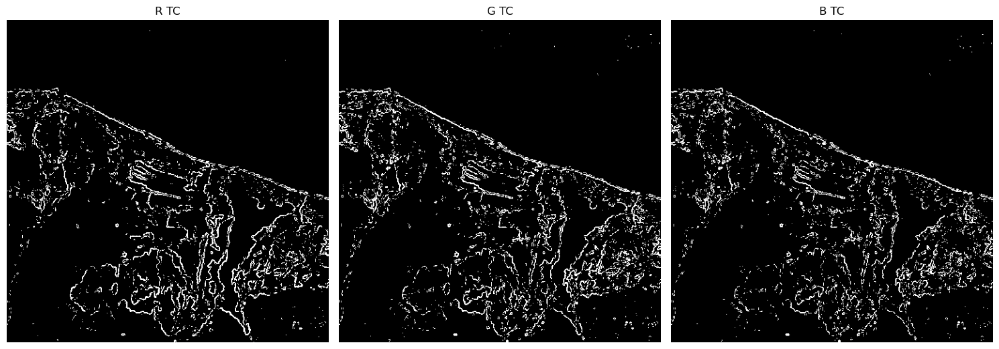

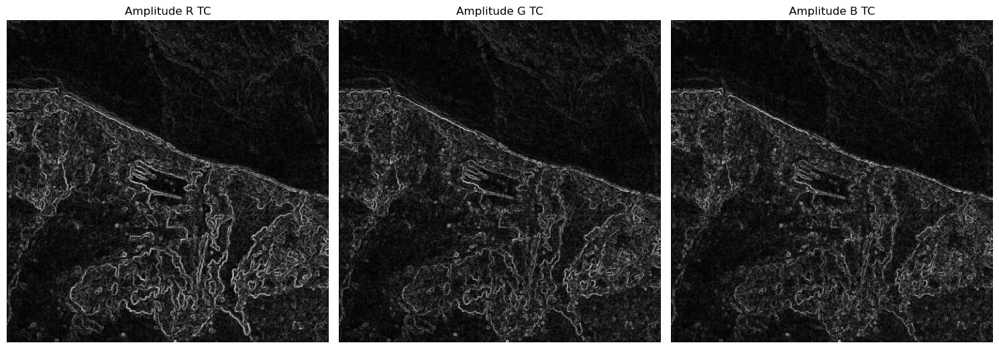

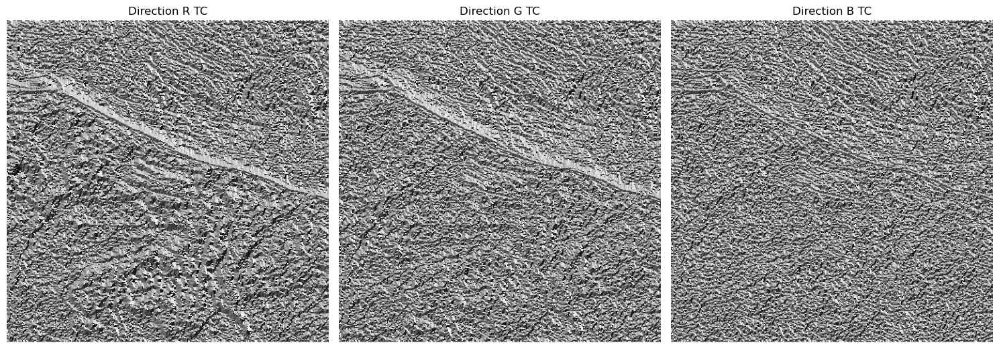

In [7]:
red_TC, green_TC, blue_TC = Split_RGB(img)

red_TC_edges, _, amplitude_TC_red, direction_TC_red = sobel(red_TC, 250)
green_TC_edges, _, amplitude_TC_green, direction_TC_green = sobel(green_TC, 210)
blue_TC_edges, _, amplitude_TC_blue, direction_TC_blue = sobel(blue_TC, 210)

rgbchannels_TC = [red_TC_edges, green_TC_edges, blue_TC_edges]
amplitudes_TC = [amplitude_TC_red, amplitude_TC_green, amplitude_TC_blue]
directions_TC = [direction_TC_red, direction_TC_green, direction_TC_blue]

display_images_in_grid(rgbchannels_TC,['R TC','G TC','B TC'],1,3,True,True)
display_images_in_grid(amplitudes_TC, ['Amplitude R TC', 'Amplitude G TC', 'Amplitude B TC'], 1, 3, True, True)
display_images_in_grid(directions_TC, ['Direction R TC', 'Direction G TC', 'Direction B TC'], 1, 3, True, True)

#Filtre Sobel sur False Color Composition

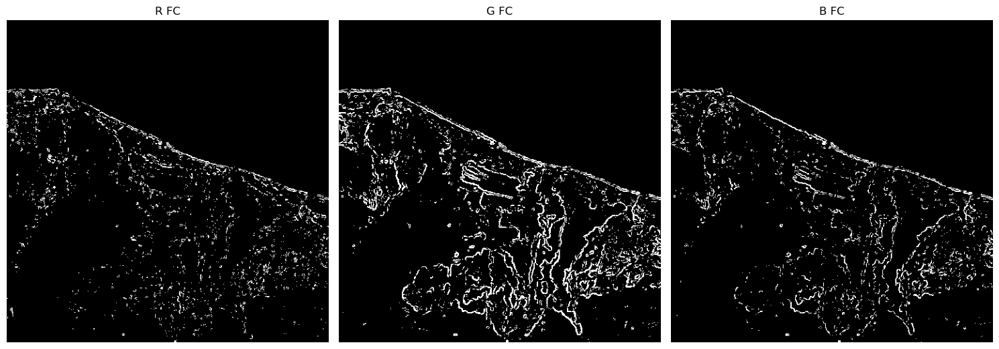

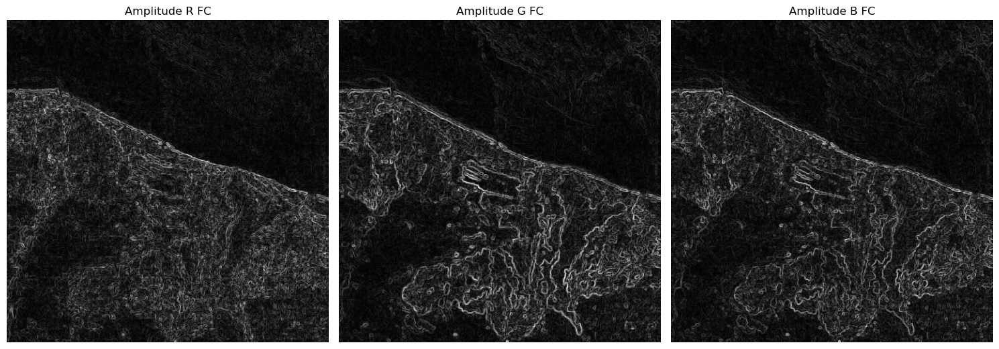

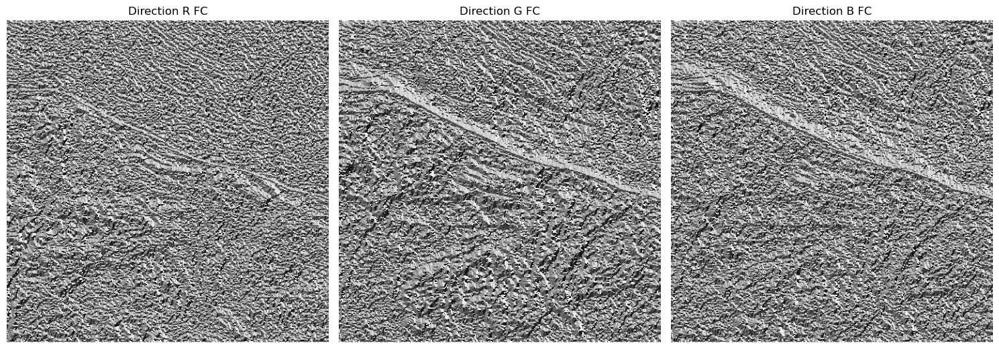

In [8]:
red_FC, green_FC, blue_FC = Split_RGB(img2)

red_FC_edges, _, amplitude_FC_red, direction_FC_red = sobel(red_FC, 210)
green_FC_edges, _, amplitude_FC_green, direction_FC_green = sobel(green_FC, 210)
blue_FC_edges, _, amplitude_FC_blue, direction_FC_blue = sobel(blue_FC, 210)

rgbchannels_FC = [red_FC_edges, green_FC_edges, blue_FC_edges]
amplitudes_FC = [amplitude_FC_red, amplitude_FC_green, amplitude_FC_blue]
directions_FC = [direction_FC_red, direction_FC_green, direction_FC_blue]

display_images_in_grid(rgbchannels_FC,['R FC','G FC','B FC'],1,3,True,True)
display_images_in_grid(amplitudes_FC, ['Amplitude R FC', 'Amplitude G FC', 'Amplitude B FC'], 1, 3, True, True)
display_images_in_grid(directions_FC, ['Direction R FC', 'Direction G FC', 'Direction B FC'], 1, 3, True, True)

Filtre Prewitt sur True Color Composition

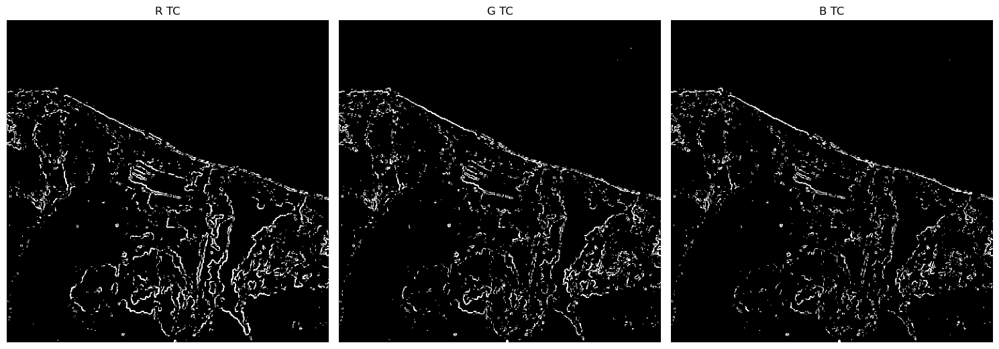

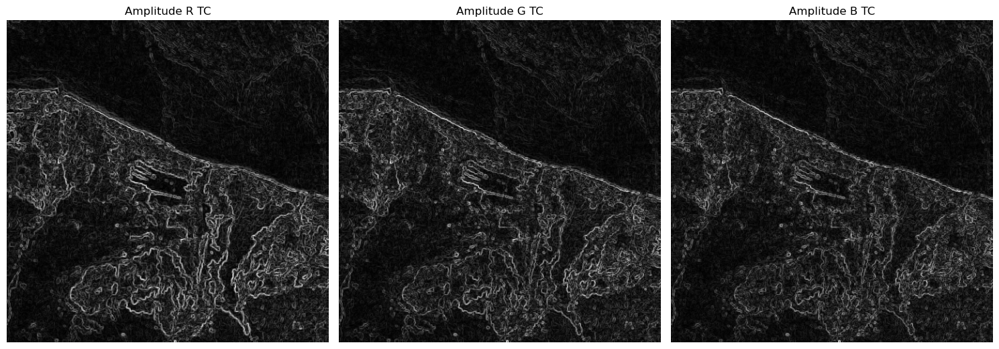

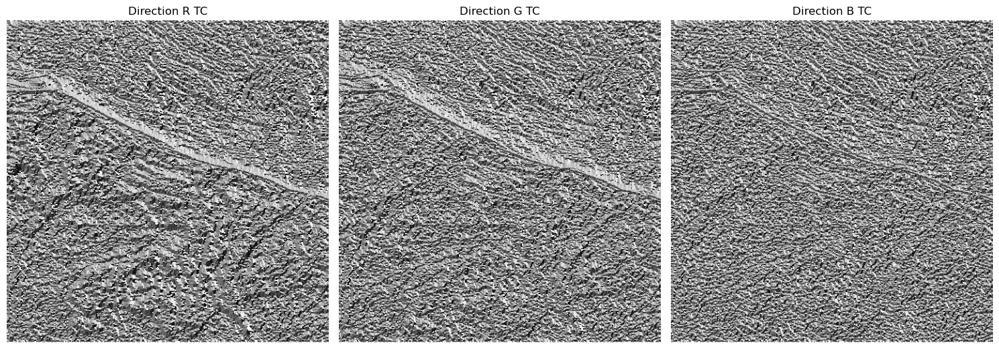

In [9]:
red_TC, green_TC, blue_TC = Split_RGB(img)

red_TC_edges, _, amplitude_TC_red, direction_TC_red = prewitt(red_TC, 200)
green_TC_edges, _, amplitude_TC_green, direction_TC_green = prewitt(green_TC, 180)
blue_TC_edges, _, amplitude_TC_blue, direction_TC_blue = prewitt(blue_TC, 180)

rgbchannels_TC = [red_TC_edges, green_TC_edges, blue_TC_edges]
amplitudes_TC = [amplitude_TC_red, amplitude_TC_green, amplitude_TC_blue]
directions_TC = [direction_TC_red, direction_TC_green, direction_TC_blue]

display_images_in_grid(rgbchannels_TC,['R TC','G TC','B TC'],1,3,True,True)
display_images_in_grid(amplitudes_TC, ['Amplitude R TC', 'Amplitude G TC', 'Amplitude B TC'], 1, 3, True, True)
display_images_in_grid(directions_TC, ['Direction R TC', 'Direction G TC', 'Direction B TC'], 1, 3, True, True)

Filtre Prewitt sur False Color Composition

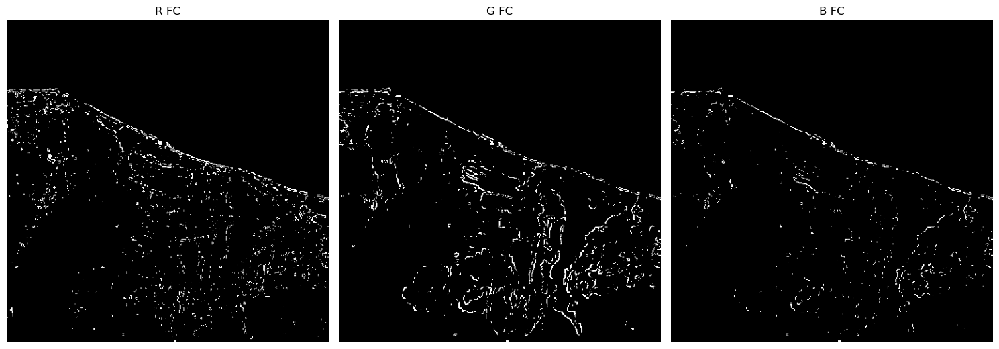

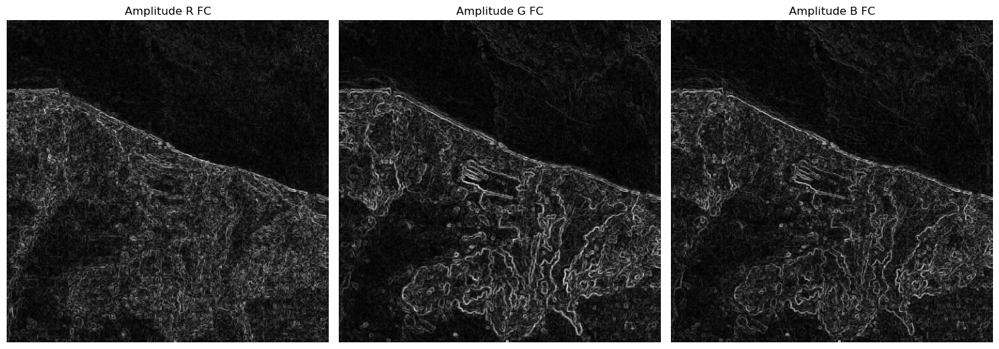

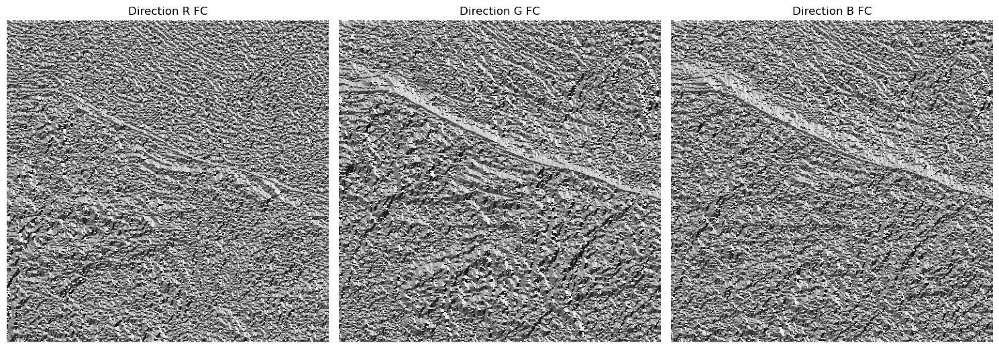

In [10]:
red_FC, green_FC, blue_FC = Split_RGB(img2)

red_FC_edges, _, amplitude_FC_red, direction_FC_red = prewitt(red_FC, 160)
green_FC_edges, _, amplitude_FC_green, direction_FC_green = prewitt(green_FC, 210)
blue_FC_edges, _, amplitude_FC_blue, direction_FC_blue = prewitt(blue_FC, 210)

rgbchannels_FC = [red_FC_edges, green_FC_edges, blue_FC_edges]
amplitudes_FC = [amplitude_FC_red, amplitude_FC_green, amplitude_FC_blue]
directions_FC = [direction_FC_red, direction_FC_green, direction_FC_blue]

display_images_in_grid(rgbchannels_FC,['R FC','G FC','B FC'],1,3,True,True)
display_images_in_grid(amplitudes_FC, ['Amplitude R FC', 'Amplitude G FC', 'Amplitude B FC'], 1, 3, True, True)
display_images_in_grid(directions_FC, ['Direction R FC', 'Direction G FC', 'Direction B FC'], 1, 3, True, True)

Filtre Laplacien sur True Color Composition

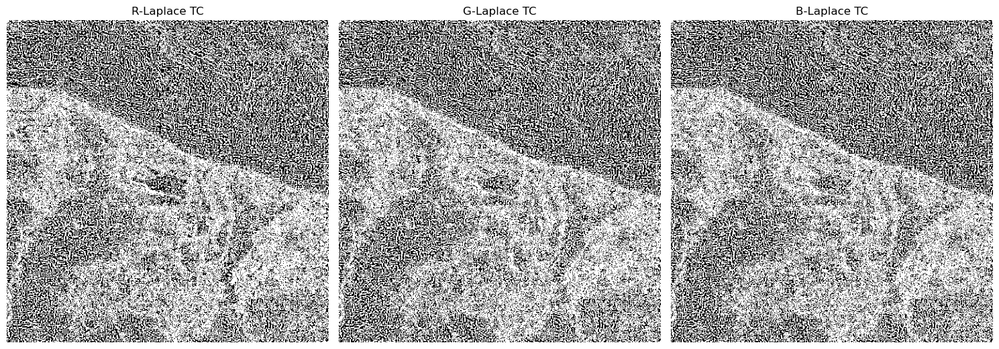

In [11]:
red_TC, green_TC, blue_TC = Split_RGB(img)

red_laplace_edges, red_laplace_gradient = laplacian(red_TC, 30)
green_laplace_edges, green_laplace_gradient = laplacian(green_TC, 30)
blue_laplace_edges, blue_laplace_gradient = laplacian(blue_TC, 30)

laplacian_channels = [red_laplace_edges, green_laplace_edges, blue_laplace_edges]
gradients = [red_laplace_gradient, green_laplace_gradient, blue_laplace_gradient]

display_images_in_grid(laplacian_channels, ['R-Laplace TC', 'G-Laplace TC', 'B-Laplace TC'], 1, 3, True, True)

Filtre Laplacien sur False Color Composition

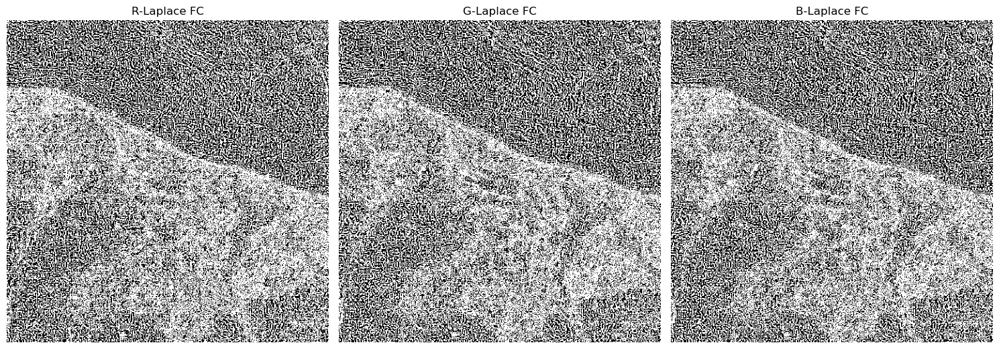

In [12]:
red_FC, green_FC, blue_FC = Split_RGB(img2)

red_laplace_edges, red_laplace_gradient = laplacian(red_FC, 30)
green_laplace_edges, green_laplace_gradient = laplacian(green_FC, 30)
blue_laplace_edges, blue_laplace_gradient = laplacian(blue_FC, 30)

laplacian_channels = [red_laplace_edges, green_laplace_edges, blue_laplace_edges]
gradients = [red_laplace_gradient, green_laplace_gradient, blue_laplace_gradient]

display_images_in_grid(laplacian_channels, ['R-Laplace FC', 'G-Laplace FC', 'B-Laplace FC'], 1, 3, True, True)

Filtre LOG sur True Color Composition

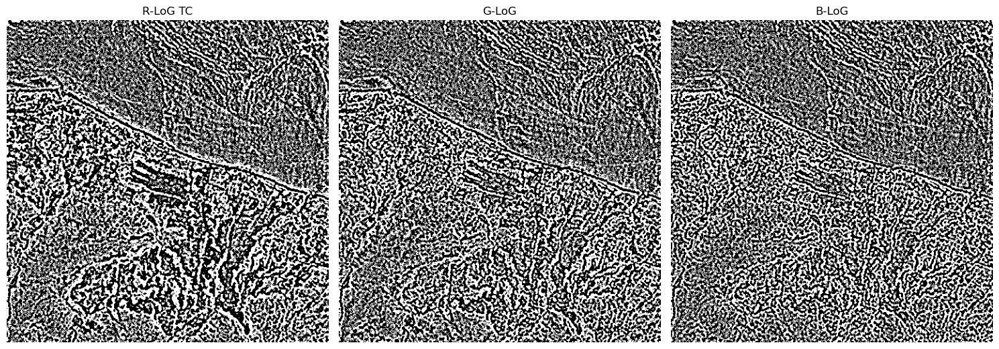

In [13]:
red_TC, green_TC, blue_TC = Split_RGB(img)

red_log_edges, red_log_gradient = log_filter(red_TC, kernel_size=5, sigma=1.5, threshold=120)
green_log_edges, green_log_gradient = log_filter(green_TC, kernel_size=5, sigma=1.5, threshold=100)
blue_log_edges, blue_log_gradient = log_filter(blue_TC, kernel_size=5, sigma=1.5, threshold=100)

log_channels = [red_log_edges, green_log_edges, blue_log_edges]
log_gradients = [red_log_gradient, green_log_gradient, blue_log_gradient]

# Afficher les bords binaires des canaux LoG
display_images_in_grid(log_channels, ['R-LoG TC', 'G-LoG', 'B-LoG'], 1, 3, True, True)

Filtre LOG sur False Color Composition

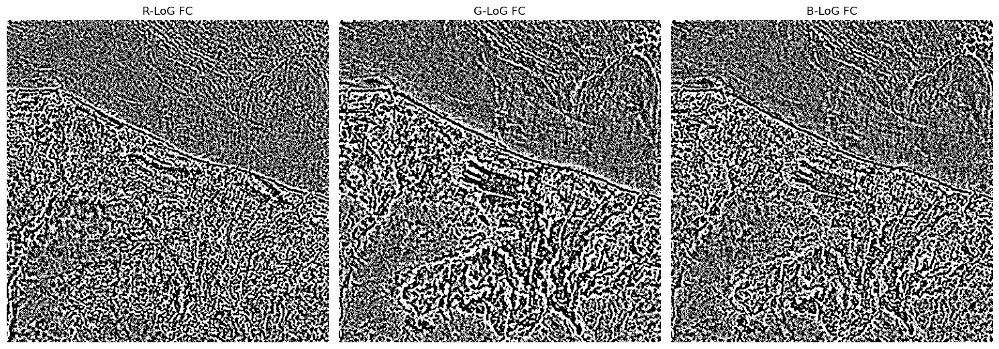

In [14]:
red_FC, green_FC, blue_FC = Split_RGB(img2)

red_log_edges, red_log_gradient = log_filter(red_FC, kernel_size=5, sigma=1.5, threshold=120)
green_log_edges, green_log_gradient = log_filter(green_FC, kernel_size=5, sigma=1.5, threshold=100)
blue_log_edges, blue_log_gradient = log_filter(blue_FC, kernel_size=5, sigma=1.5, threshold=100)

log_channels = [red_log_edges, green_log_edges, blue_log_edges]
log_gradients = [red_log_gradient, green_log_gradient, blue_log_gradient]

# Afficher les bords binaires des canaux LoG
display_images_in_grid(log_channels, ['R-LoG FC', 'G-LoG FC', 'B-LoG FC'], 1, 3, True, True)

# # Etape 2 : Segmentation 

In [20]:
def calculate_histogram(image):
    return np.bincount(image.ravel(), minlength=256)

def display_histogram(histogram, title):
    plt.figure()
    plt.title(title)
    plt.bar(range(256), histogram, width=1)
    plt.show()
    
def display_histograms(images, titles='',N=2, M=2,display=False):
    fig, axs = plt.subplots(N, M, figsize=(15, 5)) 

    for i, ax in enumerate(axs.flat):  
        if i < len(images):  
    
            ax.hist(images[i].flatten(), bins=256)
            if display == True: 
                ax.set_title(titles[i])
            ax.axis('on') 
    plt.tight_layout()
    plt.show()  
    

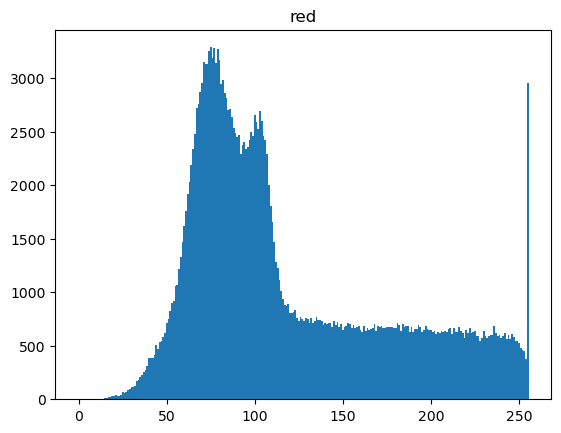

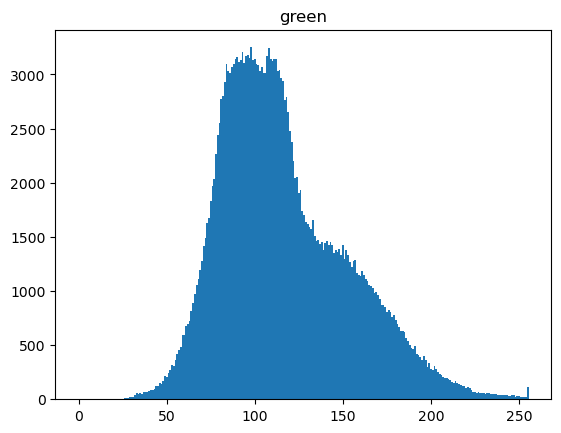

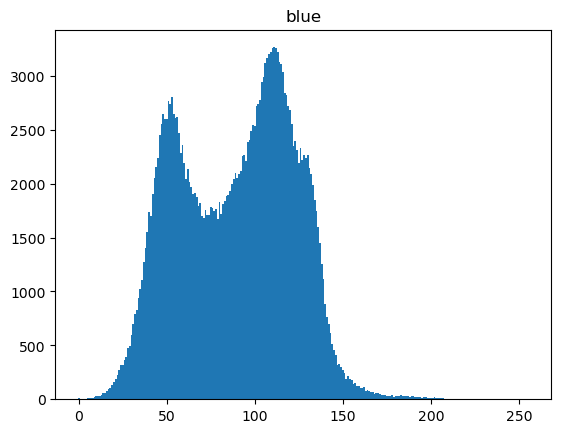

In [21]:
r, g, b = Split_RGB(img)
histogram_red = calculate_histogram(r)
histogram_green = calculate_histogram(g)
histogram_blue = calculate_histogram(b)
histograms = [histogram_red, histogram_green, histogram_blue]
display_histogram(histogram_red, "red")
display_histogram(histogram_green, "green")
display_histogram(histogram_blue, "blue")
#display_histograms(histograms, '', 1, 3, False)

In [55]:
def delete_pixels(n1, n2, histogram):
    histogram[n1:n2 + 1] = 0
    return histogram

def is_empty(histogram):
    return np.all(histogram == 0)


def binary_segmentation(image, n1, n2):
    binary_image = np.zeros_like(image, dtype=bool)
    binary_image[(image >= n1) & (image <= n2)] = True
    return binary_image

def find_peak(histogram, half_width):
    n1, n2 = -1, -1
    max_value = -1
    for i in range(1, len(histogram) - 1):
        if histogram[i] > histogram[i - 1] and histogram[i] > histogram[i + 1]:
            left = max(i - half_width, 0)
            right = min(i + half_width, 255)
            if histogram[i] > max_value:
                max_value = histogram[i]
                n1, n2 = left, right
    return n1, n2

def segment_image(image, half_width):
    segmented_regions = []
    histogram = calculate_histogram(image)
    empty = is_empty(histogram)
    while not empty:
        n1, n2 = find_peak(histogram, half_width)
        if n1 == -1 or n2 == -1:
            print("no valid peak found")
            break
        segment = binary_segmentation(image, n1, n2)
        segmented_regions.append(segment)
        
        histogram = delete_pixels(n1, n2, histogram)
        display_histogram(histogram, "remaining")
        empty = is_empty(histogram)
        
    return segmented_regions

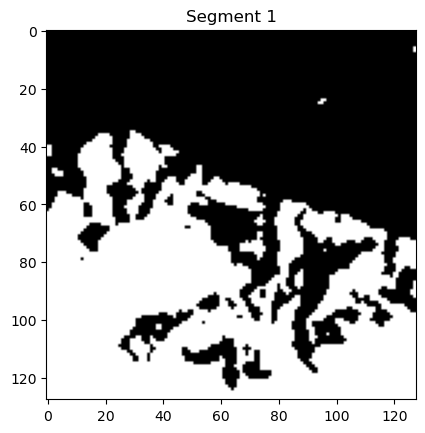

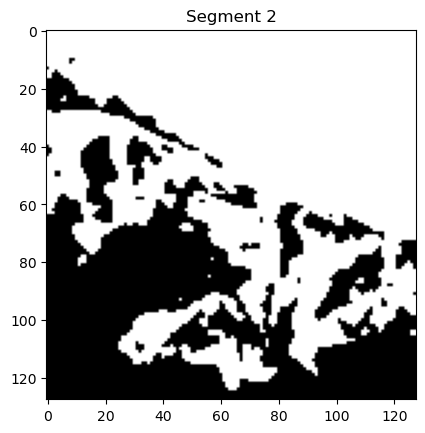

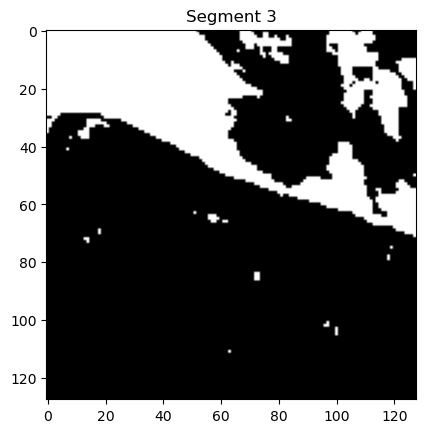

In [48]:
img = Image.open("C://Users//Trust_pc_dz//Documents//ISAT//TP2ISAT//Satellite_Imagery_Analysis//TPISAT-3//imag sat//NaturalColorImages.jpg")
resized_image = img.resize((128, 128)) 
red, green, blue = Split_RGB(resized_image)
smoothed_green = gaussian_filter(blue, sigma=1) 

segmented_images = segment_image(smoothed_green, 30)


for i, img in enumerate(segmented_images):
    plt.figure()
    plt.title(f"Segment {i+1}")
    plt.imshow(img, cmap='gray')
    plt.show()

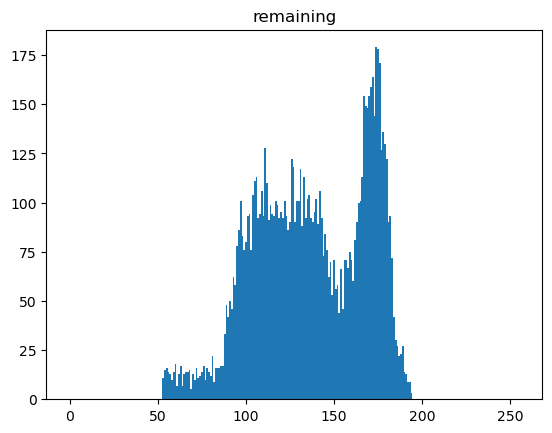

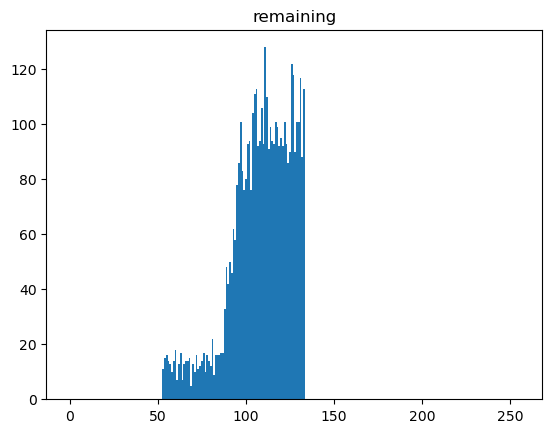

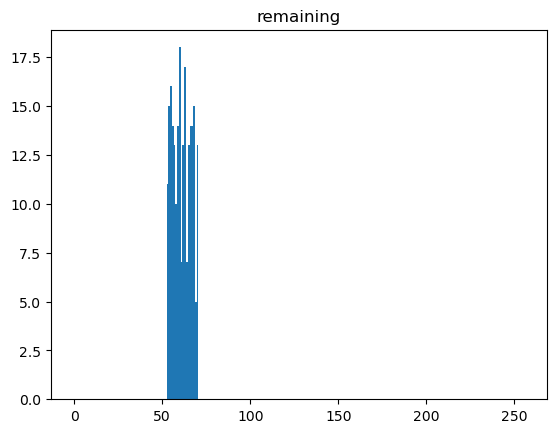

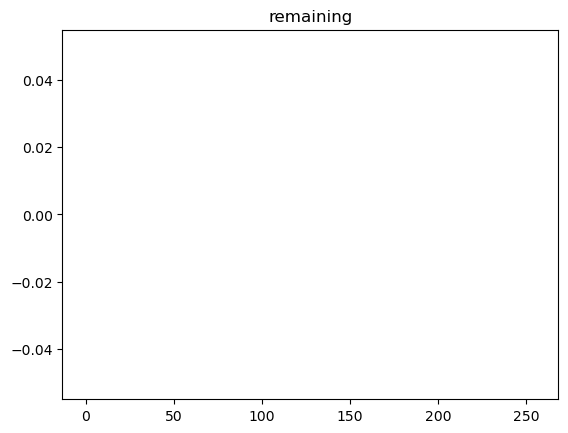

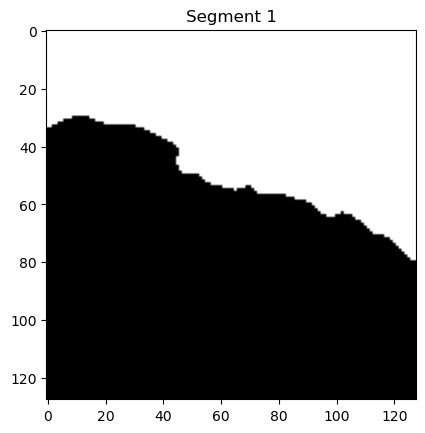

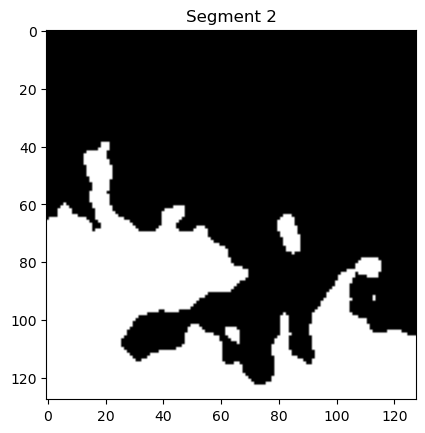

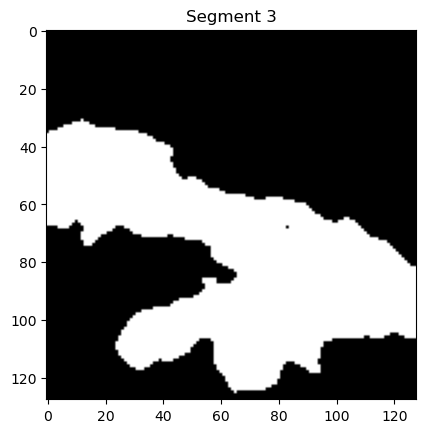

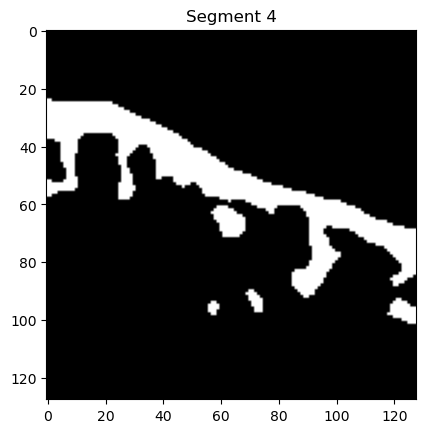

In [56]:
img2 = Image.open("C://Users//Trust_pc_dz//Documents//ISAT//TP2ISAT//Satellite_Imagery_Analysis//TPISAT-3//imag sat//FalseColorImages.jpg")
resized_image = img2.resize((128, 128)) 
red, green, blue = Split_RGB(resized_image)
smoothed_green = gaussian_filter(red, sigma=2)  

segmented_images = segment_image(smoothed_green, 40)
# Afficher les résultats
for i, img2 in enumerate(segmented_images):
    plt.figure()
    plt.title(f"Segment {i+1}")
    plt.imshow(img2, cmap='gray')
    plt.show()

# Etape 3 : Classification

In [57]:
from scipy.cluster.vq import kmeans2

def prepare_data(image):
    # Get the height and width of the image
    height, width, _ = image.shape
    
    # Create an array of coordinates
    x_coords, y_coords = np.meshgrid(np.arange(width), np.arange(height))
    
    # Flatten the image and coordinates
    red, green, blue = image[:, :, 0].flatten(), image[:, :, 1].flatten(), image[:, :, 2].flatten()
    x_coords, y_coords = x_coords.flatten(), y_coords.flatten()
    
    # Combine all data into a single array
    data = np.column_stack((red, green, blue, x_coords, y_coords)).astype(float)
    return data

def k_medians_clustering(data, k):
    # Apply K-medians clustering (using K-means as an approximation)
    centroids, labels = kmeans2(data, k, minit='points')
    return centroids, labels

In [58]:
def k_medians(data, k, max_iterations=100, tolerance=1e-4):
    # Randomly initialize centroids by selecting k random points from the data
    np.random.seed(42)
    centroids = data[np.random.choice(data.shape[0], k, replace=False)]
    
    for iteration in range(max_iterations):
        # Assign each point to the nearest centroid based on Manhattan distance
        distances = np.abs(data[:, None, :] - centroids[None, :, :]).sum(axis=2)  # Manhattan distance
        labels = np.argmin(distances, axis=1)
        
        # Calculate new centroids as the median of points in each cluster
        new_centroids = np.zeros_like(centroids)
        for i in range(k):
            cluster_points = data[labels == i]
            if len(cluster_points) > 0:  # Avoid empty clusters
                new_centroids[i] = np.median(cluster_points, axis=0)
            else:  # Handle empty clusters by reinitializing randomly
                new_centroids[i] = data[np.random.choice(data.shape[0])]
        
        # Check for convergence (centroid movement is below tolerance)
        if np.all(np.abs(new_centroids - centroids) < tolerance):
            print(f"Converged after {iteration + 1} iterations.")
            break
        
        centroids = new_centroids
    
    return centroids, labels

Converged after 6 iterations.
Converged after 7 iterations.
Converged after 15 iterations.
Converged after 17 iterations.


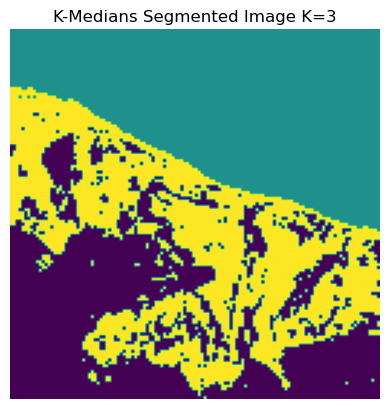

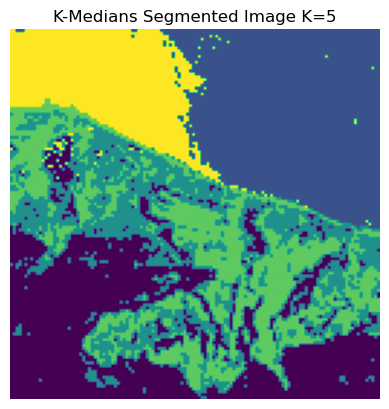

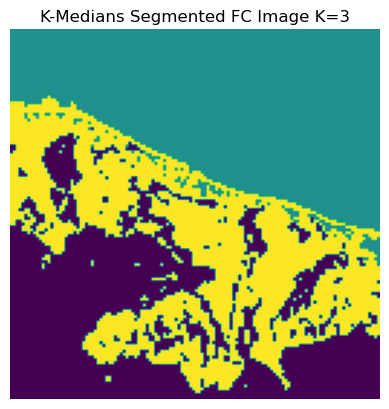

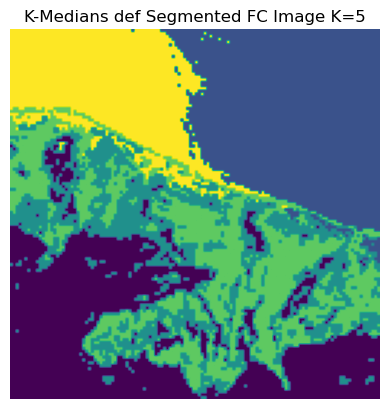

In [60]:
image_path = "C://Users//Trust_pc_dz//Documents//ISAT//TP2ISAT//Satellite_Imagery_Analysis//TPISAT-3//imag sat//NaturalColorImages.jpg"
img = Image.open(image_path).resize((128, 128))
image_array = np.array(img)

image_path2 = "C://Users//Trust_pc_dz//Documents//ISAT//TP2ISAT//Satellite_Imagery_Analysis//TPISAT-3//imag sat//FalseColorImages.jpg"
img2 = Image.open(image_path2).resize((128, 128))
image_array2 = np.array(img2)


data = prepare_data(image_array)
data2 = prepare_data(image_array2)

k5, k3 = 5, 3
centroids3, labels3 = k_medians(data, k3)
centroids3_fc, labels3_fc = k_medians(data2, k3)

centroids5, labels5 = k_medians(data, k5)
centroids5_fc, labels5_fc = k_medians(data2, k5)
#centroids_def, labels_def = k_medians_clustering(data, k)


# Reshape labels to match the image shape
segmented_img = labels3.reshape(img.size[::-1])
segmented_img5 = labels5.reshape(img.size[::-1])

segmented_img_fc = labels3_fc.reshape(img.size[::-1])
segmented_img_fc_5 = labels5_fc.reshape(img.size[::-1])
#segmented_img_def = labels_def.reshape(img.size[::-1])

# Display the clustered image
plt.imshow(segmented_img, cmap='viridis')
plt.title("K-Medians Segmented Image K=3")
plt.axis("off")
plt.show()
# Display the clustered image
plt.imshow(segmented_img5, cmap='viridis')
plt.title("K-Medians Segmented Image K=5")
plt.axis("off")
plt.show()

plt.imshow(segmented_img_fc, cmap='viridis')
plt.title("K-Medians Segmented FC Image K=3")
plt.axis("off")
plt.show()
# Display the clustered image
plt.imshow(segmented_img_fc_5, cmap='viridis')
plt.title("K-Medians def Segmented FC Image K=5")
plt.axis("off")
plt.show()